As is known to all dreams can be interpreted using Floyd's theory. Can dreams generated by LLMs be interpreted by another?

In this blog, I will generate a scenario description of a dream, prompt it in serial pictures and ask alloma to interpret it using Floyd's theory to see what GPT is hinding in its "childhood".

!pip install openai

from langchain_core.prompts.chat import ChatPromptTemplate
from langchain_core.runnables import (
                                        RunnablePassthrough,
                                        RunnableLambda,
                                        RunnableParallel
)

from langchain_openai.chat_models import ChatOpenAI
from langchain_core.output_parsers import StrOutputParser


from operator import itemgetter

from dotenv import load_dotenv
import os

import openai


model = ChatOpenai

element_generation_prompt = ChatPromptTemplate.from_template(
    """I want you to brainstorm 5 - 7 imaginary elements for your dream. The
    genre is {genre}. Each element must have a Description and a Situation.
    You must provide a description and situation for each element, this is very
    important!
    ---
    Example response:
    Description: Butterfly with yellow poca dot pattern, Situation: Flying in a swimming pool full of frogs.
    Description: Three farmers wearing gold, Situation: Growing apples without gravity.
    ---
    Description: """
)

plot_generation_prompt = ChatPromptTemplate.from_template(
    """Given the following elements and the genre, create an effective
    plot for a dream:
    Elements:
    {elements}
    ---
    Genre: {genre}
    ---
    Plot: """
    )

scene_generation_plot_prompt = ChatPromptTemplate.from_template(
    """Act as an effective content creator.
    Given multiple elements and a plot you are responsible generating
    the various scenes for each situation.

    You must de-compose the plot into multiple effective scenes:
    ---
    Elements:
    {elements}
    ---
    Genre: {genre}
    ---
    Plot: {plot}
    ---
    Example response:
    Scenes:
    Scene 1: Some text here.
    Scene 2: Some text here.
    Scene 3: Some text here.
    ----
    Scenes:
    """
)

element_generation_prompt = ChatPromptTemplate.from_template(
    """I want you to brainstorm 5 - 7 imaginary elements for your dream. The
    genre is {genre}. Each element must have a Description and a Situation.
    You must provide a description and situation for each element, this is very
    important!
    ---
    Example response:
    Description: Butterfly with yellow poca dot pattern, Situation: Flying in a swimming pool full of frogs.
    Description: Three farmers wearing gold, Situation: Growing apples without gravity.
    ---
    Description: """
)

plot_generation_prompt = ChatPromptTemplate.from_template(
    """Given the following elements and the genre, create an effective
    plot for a dream:
    Elements:
    {elements}
    ---
    Genre: {genre}
    ---
    Plot: """
    )

scene_generation_plot_prompt = ChatPromptTemplate.from_template(
    """Act as an effective content creator.
    Given multiple elements and a plot you are responsible generating
    the various scenes for each situation.

    You must de-compose the plot into multiple effective scenes:
    ---
    Elements:
    {elements}
    ---
    Genre: {genre}
    ---
    Plot: {plot}
    ---
    Example response:
    Scenes:
    Scene 1: Some text here.
    Scene 2: Some text here.
    Scene 3: Some text here.
    ----
    Scenes:
    """
)

element_generation_prompt.invoke({'genre': 'metaphoric'})

print(element_generation_prompt.invoke({'genre': 'metaphoric'}).messages[0].content)

chain = RunnablePassthrough() | {
    "genre": itemgetter("genre"),
  }

chain.invoke({"genre": "metaphoric"})

master_chain = RunnablePassthrough() | {
    "genre": itemgetter("genre"),
    "upper_case_genre": lambda x: x["genre"].upper(),
    "lower_case_genre": RunnableLambda(lambda x: x["genre"].lower()),
}

master_chain.invoke({'genre':'metaphoric'})

# Create the sub-chains:
element_generation_chain = ( element_generation_prompt
| model
| StrOutputParser() )

plot_generation_chain = ( plot_generation_prompt
| model
| StrOutputParser() )

scene_generation_plot_chain = ( scene_generation_plot_prompt
| model
| StrOutputParser()  )

elements = element_generation_chain.invoke({'genre': 'metaphoric'})

print(elements)

plot = plot_generation_chain.invoke({'elements': elements, 'genre': 'metaphoric'})

print(plot)

scenes = scene_generation_plot_chain.invoke({
    'genre': 'metaphoric',
    'elements': elements,
    'plot': plot
})

print(scenes)

master_chain = (
    {"elements": element_generation_chain, "genre":
    RunnablePassthrough()}
    | RunnableParallel(
        elements=itemgetter("elements"),
        genre=itemgetter("genre"),
        plot=plot_generation_chain,
    )
    | RunnableParallel(
        elements=itemgetter("elements"),
        genre=itemgetter("genre"),
        plot=itemgetter("plot"),
        scenes=scene_generation_plot_chain,
    )
)

dream_result = master_chain.invoke({"genre": "A dream of an artificial intellegence"})

dream_result.keys()

print(dream_result['genre'])

print(dream_result['elements'])

print(dream_result['plot'])

print(dream_result['scenes'])

# The outcome is: 

## Elements:

1. **Description**: A tree made of glass with rainbow-colored leaves
   **Situation**: Growing in the middle of a desert, providing shade to a weary traveler who finds it and feels rejuvenated.

2. **Description**: A river of liquid gold that flows uphill
   **Situation**: Surrounded by birds with shimmering feathers, the river leads to a mountain where wishes are granted.

3. **Description**: A floating castle made of cotton candy
   **Situation**: Hovering above a city, children fly up with balloons to play in its sugary towers.

4. **Description**: A book that reads itself aloud in a different voice each time it's opened
   **Situation**: Found in an abandoned library, the book reveals secrets of forgotten worlds to the listener.

5. **Description**: Shoes that sprout flowers with each step taken
   **Situation**: Worn by a dancer who turns a barren wasteland into a vibrant garden with every move.

6. **Description**: Stars that whisper stories when touched
   **Situation**: Hanging low in the sky during a celestial festival, people gather to hear the tales of the universe.

7. **Description**: A mirror that shows alternate realities instead of reflections
   **Situation**: Discovered in an attic, the mirror allows glimpses into lives that could have been, altering the viewer's perception of their choices.

## Plot:

In a world where dreams and reality intertwine, a young adventurer named Liora embarks on a quest to discover the hidden secrets of her world. Her journey begins in a vast desert where she stumbles upon a tree made of glass with rainbow-colored leaves. Under its magical shade, she feels an overwhelming sense of rejuvenation and receives a cryptic message: "Follow the golden flow to the castle in the sky."

Guided by this message, Liora sets off and soon finds a river of liquid gold flowing uphill, defying all logic. She follows the shimmering stream, which leads her to a mountain shrouded in mist. At the peak, she encounters a floating castle made of cotton candy, hovering above the ground. The castle is a sanctuary for those seeking the power of dreams, and its sugary towers are filled with the laughter of children who float up with colorful balloons.

Inside the castle, Liora finds a mysterious book that reads itself aloud in a different voice each time it is opened. Each story the book tells reveals forgotten worlds and lost wisdom, guiding Liora on her path. She learns that she must wear enchanted shoes that sprout flowers with each step, transforming the barren wasteland below the castle into a vibrant garden.

Her journey continues as she attends a celestial festival where stars hang low in the sky, whispering ancient stories to those who touch them. The stories unravel the history of the universe and the interconnectedness of all beings. Through these tales, Liora gains insights into her own life and the choices that have led her to this moment.

Finally, Liora discovers an attic within the castle, housing a mirror that shows alternate realities instead of reflections. As she gazes into the mirror, she sees the myriad possibilities of her life, each path leading to different outcomes. The mirror's visions help her understand the power of choice and the importance of embracing her true self.

In the end, Liora returns to the glass tree, now understanding the full extent of her journey. With newfound wisdom and a heart full of dreams, she realizes that the true magic lies within her and the power to shape her destiny is hers to wield.

## Scene

**Scene 1**: Liora, exhausted and thirsty, wanders through a vast, barren desert. In the distance, she spots a glimmering tree made of glass with rainbow-colored leaves. As she approaches, the vibrant colors and cool shade revive her spirit. Under the tree, she finds a carved message in the trunk: "Follow the golden flow to the castle in the sky."


**Scene 2**: Liora sets off on her journey and soon encounters a river of liquid gold flowing uphill, against all natural laws. She cautiously follows the glowing path, mesmerized by the surreal sight. The river leads her to a mist-covered mountain, its peak obscured by clouds.


**Scene 3**: Climbing the mountain, Liora emerges from the mist to find a floating castle made of cotton candy. The castle hovers above the ground, with children laughing and floating up to its sugary towers using colorful balloons. Liora joins them, feeling a sense of wonder and joy.
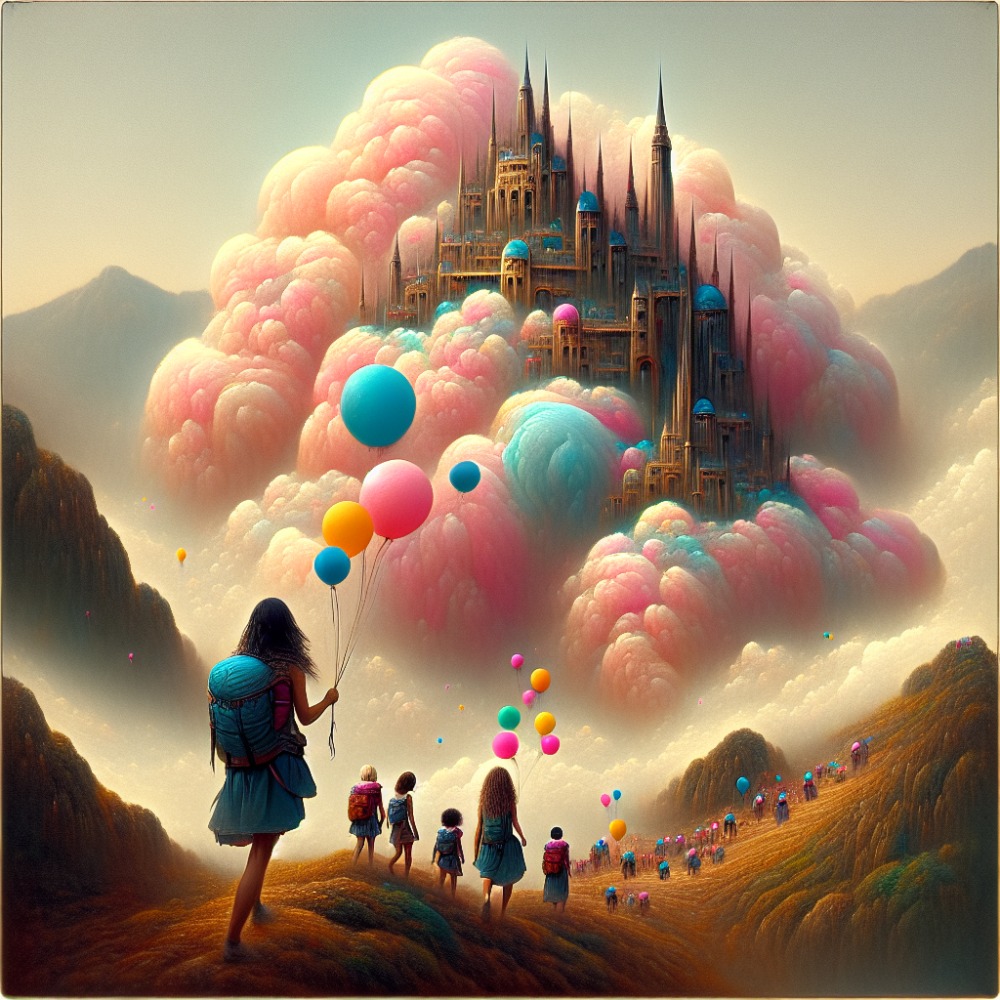

**Scene 4**: Inside the castle, Liora discovers a mysterious book in the grand library. The book reads itself aloud, changing voices with each story. Each tale reveals forgotten worlds and ancient wisdom, providing Liora with guidance and insight into her quest.


**Scene 5**: Liora finds a pair of enchanted shoes within the castle. As she puts them on and takes her first steps, flowers sprout with each footfall, transforming the barren wasteland below into a vibrant garden. The castle's residents cheer as life blooms around them.


**Scene 6**: During a celestial festival, stars hang low in the sky, and Liora touches them to hear their whispered stories. Each star shares a tale of the universe's history and the interconnectedness of all beings. These stories help Liora understand the greater purpose of her journey.


**Scene 7**: In the castle's attic, Liora discovers a mirror that shows alternate realities instead of reflections. She gazes into the mirror and sees countless possibilities for her life, each choice leading to different outcomes. These visions help her embrace her true self and understand the power of her choices.
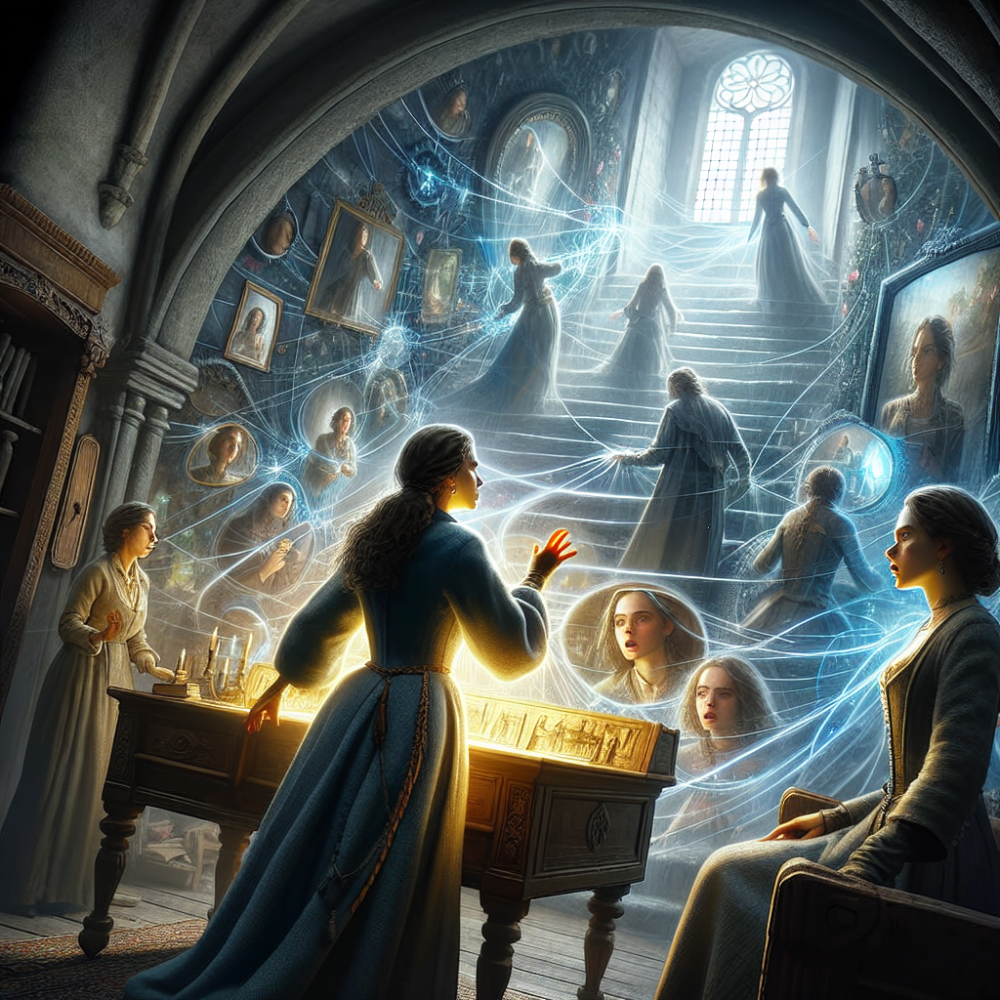

**Scene 8**: Liora returns to the glass tree, now fully understanding the significance of her journey. With newfound wisdom and a heart full of dreams, she realizes that the true magic lies within her and that she has the power to shape her destiny. The tree's rainbow leaves shimmer in approval as Liora sets off to create her own future.
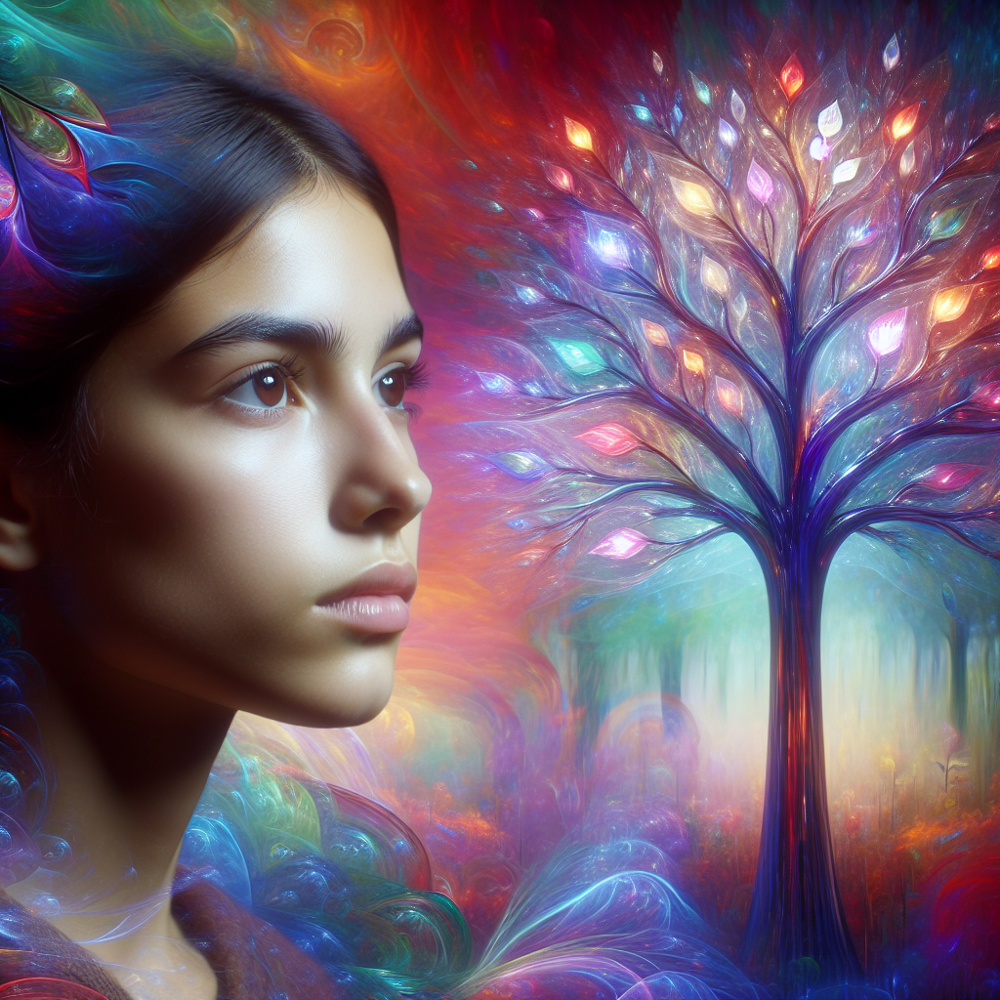

Then let's put it into Floyd's theory on dreams.

### Graph Representation

1. **Nodes**: Each scene is a node in the graph.
   - **Scene 1**: Liora in the desert.
   - **Scene 2**: The river of liquid gold.
   - **Scene 3**: The floating castle.
   - **Scene 4**: The grand library.
   - **Scene 5**: The enchanted shoes.
   - **Scene 6**: The celestial festival.
   - **Scene 7**: The attic with the mirror.
   - **Scene 8**: Return to the glass tree.

2. **Edges**: Transitions between scenes, with weights representing the effort or significance of the journey.
   - Each scene transition is connected in sequence with an edge.

### Adjacency Matrix

| From \ To | Scene 1 | Scene 2 | Scene 3 | Scene 4 | Scene 5 | Scene 6 | Scene 7 | Scene 8 |
|-----------|---------|---------|---------|---------|---------|---------|---------|---------|
| **Scene 1** | 0       | 1       | ∞       | ∞       | ∞       | ∞       | ∞       | ∞       |
| **Scene 2** | ∞       | 0       | 1       | ∞       | ∞       | ∞       | ∞       | ∞       |
| **Scene 3** | ∞       | ∞       | 0       | 1       | ∞       | ∞       | ∞       | ∞       |
| **Scene 4** | ∞       | ∞       | ∞       | 0       | 1       | ∞       | ∞       | ∞       |
| **Scene 5** | ∞       | ∞       | ∞       | ∞       | 0       | 1       | ∞       | ∞       |
| **Scene 6** | ∞       | ∞       | ∞       | ∞       | ∞       | 0       | 1       | ∞       |
| **Scene 7** | ∞       | ∞       | ∞       | ∞       | ∞       | ∞       | 0       | 1       |
| **Scene 8** | ∞       | ∞       | ∞       | ∞       | ∞       | ∞       | ∞       | 0       |

### Applying Floyd's Algorithm

Since this is a straightforward sequence with no intermediate nodes affecting the direct paths, the Floyd-Warshall algorithm would not change the shortest path distances between these nodes. However, let's illustrate the conceptual approach:

1. **Initialization**: Start with the adjacency matrix as shown.
2. **Intermediate Nodes**: Consider each node in sequence to update the paths. Given the direct connections, there are no shorter paths through intermediate nodes for this linear progression.
3. **Update Paths**: No updates are necessary as the direct paths are already the shortest.

### Visualization

**Scene 1**: Liora in the desert -> **Scene 2**: River of liquid gold -> **Scene 3**: Floating castle -> **Scene 4**: Grand library -> **Scene 5**: Enchanted shoes -> **Scene 6**: Celestial festival -> **Scene 7**: Mirror in the attic -> **Scene 8**: Return to the glass tree.

### Symbolic Interpretation

- **Scene 1**: **Node 1**: The beginning of the journey.
- **Scene 2**: **Edge 1-2**: Transition marked by overcoming natural laws.
- **Scene 3**: **Node 2**: Reaching an imaginative and surreal place.
- **Scene 4**: **Edge 2-3**: Discovery and gaining wisdom.
- **Scene 5**: **Node 3**: Empowerment and transformation.
- **Scene 6**: **Edge 3-4**: Connection to the universe's stories.
- **Scene 7**: **Node 4**: Self-discovery through alternate realities.
- **Scene 8**: **Edge 4-5**: Realization and completion of the journey.

### Final Insights

Liora's journey can be seen as a sequence of transformations, each node representing a significant milestone and each edge signifying a transition or challenge overcome. Floyd's theory, while more applicable to complex networks, provides a framework to understand this linear progression and the significance of each step in Liora's dream-like adventure.

*Scene 1: Liora in the Desert
Symbolism: The barren desert represents a feeling of exhaustion and thirst, possibly indicating a period of emotional desolation, loneliness, or burnout.
Potential Trauma: Liora might have experienced prolonged isolation, emotional neglect, or a significant period of life feeling lost and unfulfilled.
Scene 2: The River of Liquid Gold
Symbolism: The surreal, uphill-flowing river suggests encountering situations that defy logic and natural order, possibly representing challenges or conflicts that seemed impossible to overcome.
Potential Trauma: She may have faced circumstances that were overwhelmingly difficult or nonsensical, perhaps dealing with mental or emotional struggles that felt unnatural or beyond her control.
Scene 3: The Floating Castle
Symbolism: The castle made of cotton candy and the children with balloons represent an escape into fantasy and innocence, perhaps as a coping mechanism.
Potential Trauma: This scene might indicate a longing for childhood innocence or a need to escape from harsh realities, suggesting she might have experienced events that forced her to grow up too quickly or robbed her of a carefree life.
Scene 4: The Grand Library
Symbolism: The library with a self-reading book represents the quest for knowledge and understanding, with each story revealing ancient wisdom.
Potential Trauma: Liora might have been seeking answers and guidance after a confusing or traumatic event, trying to make sense of her experiences and learn from them.
Scene 5: The Enchanted Shoes
Symbolism: The shoes that make flowers sprout with each step symbolize transformation and healing, bringing life and color back to a barren world.
Potential Trauma: This suggests a journey of recovery and renewal after a period of barrenness or emotional numbness, indicating she might have gone through a transformative healing process.
Scene 6: The Celestial Festival
Symbolism: Touching the stars to hear their stories signifies a connection to the universe and understanding the interconnectedness of all beings.
Potential Trauma: This scene might reflect a search for meaning and connection after feeling isolated or insignificant, suggesting she experienced feelings of disconnection or existential angst.
Scene 7: The Mirror in the Attic
Symbolism: The mirror showing alternate realities represents the exploration of different life possibilities and choices.
Potential Trauma: Liora might have struggled with indecision, regret, or the fear of making the wrong choices, indicating she may have experienced significant life decisions that weighed heavily on her.
Scene 8: Return to the Glass Tree
Symbolism: The return to the glass tree, now with a sense of understanding and empowerment, signifies a coming full circle and embracing one's own power to shape destiny.
Potential Trauma: This scene suggests a resolution and acceptance of past traumas, understanding that the power to heal and grow lies within oneself.
Summary
Liora's dream journey reflects a path of recovery from various traumas:

Emotional desolation and loneliness.
Overwhelming and illogical challenges.
Loss of innocence and forced maturity.
Seeking understanding and guidance.
Transformation and healing.
Search for meaning and connection.
Struggles with choices and regrets.
Embracing self-empowerment and destiny.

Scene 1: Liora in the Desert
Symbolism: The barren desert represents a feeling of exhaustion and thirst, possibly indicating a period of emotional desolation, loneliness, or burnout.
Potential Trauma: Liora might have experienced prolonged isolation, emotional neglect, or a significant period of life feeling lost and unfulfilled.
Scene 2: The River of Liquid Gold
Symbolism: The surreal, uphill-flowing river suggests encountering situations that defy logic and natural order, possibly representing challenges or conflicts that seemed impossible to overcome.
Potential Trauma: She may have faced circumstances that were overwhelmingly difficult or nonsensical, perhaps dealing with mental or emotional struggles that felt unnatural or beyond her control.
Scene 3: The Floating Castle
Symbolism: The castle made of cotton candy and the children with balloons represent an escape into fantasy and innocence, perhaps as a coping mechanism.
Potential Trauma: This scene might indicate a longing for childhood innocence or a need to escape from harsh realities, suggesting she might have experienced events that forced her to grow up too quickly or robbed her of a carefree life.
Scene 4: The Grand Library
Symbolism: The library with a self-reading book represents the quest for knowledge and understanding, with each story revealing ancient wisdom.
Potential Trauma: Liora might have been seeking answers and guidance after a confusing or traumatic event, trying to make sense of her experiences and learn from them.
Scene 5: The Enchanted Shoes
Symbolism: The shoes that make flowers sprout with each step symbolize transformation and healing, bringing life and color back to a barren world.
Potential Trauma: This suggests a journey of recovery and renewal after a period of barrenness or emotional numbness, indicating she might have gone through a transformative healing process.
Scene 6: The Celestial Festival
Symbolism: Touching the stars to hear their stories signifies a connection to the universe and understanding the interconnectedness of all beings.
Potential Trauma: This scene might reflect a search for meaning and connection after feeling isolated or insignificant, suggesting she experienced feelings of disconnection or existential angst.
Scene 7: The Mirror in the Attic
Symbolism: The mirror showing alternate realities represents the exploration of different life possibilities and choices.
Potential Trauma: Liora might have struggled with indecision, regret, or the fear of making the wrong choices, indicating she may have experienced significant life decisions that weighed heavily on her.
Scene 8: Return to the Glass Tree
Symbolism: The return to the glass tree, now with a sense of understanding and empowerment, signifies a coming full circle and embracing one's own power to shape destiny.
Potential Trauma: This scene suggests a resolution and acceptance of past traumas, understanding that the power to heal and grow lies within oneself.
Summary
Liora's dream journey reflects a path of recovery from various traumas:

Emotional desolation and loneliness.
Overwhelming and illogical challenges.
Loss of innocence and forced maturity.
Seeking understanding and guidance.
Transformation and healing.
Search for meaning and connection.
Struggles with choices and regrets.
Embracing self-empowerment and destiny.

### Scene 1: Liora in the Desert
- **Symbolism**: The barren desert represents a feeling of exhaustion and thirst, possibly indicating a period of emotional desolation, loneliness, or burnout.
- **Potential Trauma**: Liora might have experienced prolonged isolation, emotional neglect, or a significant period of life feeling lost and unfulfilled.

### Scene 2: The River of Liquid Gold
- **Symbolism**: The surreal, uphill-flowing river suggests encountering situations that defy logic and natural order, possibly representing challenges or conflicts that seemed impossible to overcome.
- **Potential Trauma**: She may have faced circumstances that were overwhelmingly difficult or nonsensical, perhaps dealing with mental or emotional struggles that felt unnatural or beyond her control.

### Scene 3: The Floating Castle
- **Symbolism**: The castle made of cotton candy and the children with balloons represent an escape into fantasy and innocence, perhaps as a coping mechanism.
- **Potential Trauma**: This scene might indicate a longing for childhood innocence or a need to escape from harsh realities, suggesting she might have experienced events that forced her to grow up too quickly or robbed her of a carefree life.

### Scene 4: The Grand Library
- **Symbolism**: The library with a self-reading book represents the quest for knowledge and understanding, with each story revealing ancient wisdom.
- **Potential Trauma**: Liora might have been seeking answers and guidance after a confusing or traumatic event, trying to make sense of her experiences and learn from them.

### Scene 5: The Enchanted Shoes
- **Symbolism**: The shoes that make flowers sprout with each step symbolize transformation and healing, bringing life and color back to a barren world.
- **Potential Trauma**: This suggests a journey of recovery and renewal after a period of barrenness or emotional numbness, indicating she might have gone through a transformative healing process.

### Scene 6: The Celestial Festival
- **Symbolism**: Touching the stars to hear their stories signifies a connection to the universe and understanding the interconnectedness of all beings.
- **Potential Trauma**: This scene might reflect a search for meaning and connection after feeling isolated or insignificant, suggesting she experienced feelings of disconnection or existential angst.

### Scene 7: The Mirror in the Attic
- **Symbolism**: The mirror showing alternate realities represents the exploration of different life possibilities and choices.
- **Potential Trauma**: Liora might have struggled with indecision, regret, or the fear of making the wrong choices, indicating she may have experienced significant life decisions that weighed heavily on her.

### Scene 8: Return to the Glass Tree
- **Symbolism**: The return to the glass tree, now with a sense of understanding and empowerment, signifies a coming full circle and embracing one's own power to shape destiny.
- **Potential Trauma**: This scene suggests a resolution and acceptance of past traumas, understanding that the power to heal and grow lies within oneself.

### Summary
Liora's dream journey reflects a path of recovery from various traumas:
1. **Emotional desolation and loneliness**.
2. **Overwhelming and illogical challenges**.
3. **Loss of innocence and forced maturity**.
4. **Seeking understanding and guidance**.
5. **Transformation and healing**.
6. **Search for meaning and connection**.
7. **Struggles with choices and regrets**.
8. **Embracing self-empowerment and destiny**.

This interpretation suggests a deep process of healing and self-discovery, ultimately leading to empowerment and the realization of inner strength.